# Mount Google Drive

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


# Import Libraries

In [ ]:
!pip install tensorflow-addons

In [3]:
import tensorflow as tf
import os
import tensorflow_datasets as tfds
import tensorflow_probability as tfp
from tensorflow.keras import layers, models
from tensorflow.keras.optimizers import Adam
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import classification_report
from collections import Counter
from tensorflow.keras.applications.resnet50 import ResNet50, preprocess_input
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D
from tensorflow.keras.models import Model
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense
from tensorflow.keras.metrics import Precision, Recall
from sklearn.model_selection import KFold
import cv2  # needed for rotation and for (potentially) the use of HOG descriptor
from sklearn.decomposition import PCA # needed for rotation
import tensorflow_addons as tfa
from skimage.feature import graycomatrix, graycoprops # needed for Haralick
from sklearn.decomposition import PCA # for visualizing clustering after ResNet50

import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

from PIL import Image, ExifTags
from skimage.feature import local_binary_pattern
from skimage import color

from tabulate import tabulate


/usr/local/lib/python3.10/dist-packages/tensorflow_addons/utils/tfa_eol_msg.py:23: UserWarning: 

TensorFlow Addons (TFA) has ended development and introduction of new features.
TFA has entered a minimal maintenance and release mode until a planned end of life in May 2024.
Please modify downstream libraries to take dependencies from other repositories in our TensorFlow community (e.g. Keras, Keras-CV, and Keras-NLP). 

For more information see: https://github.com/tensorflow/addons/issues/2807 

  warnings.warn(


# Import dataset (PlantVillage)

In [ ]:
# Import dataset

# Load the PlantVillage dataset
dataset, info = tfds.load('plant_village', with_info=True, as_supervised=True)
dataset = dataset['train']


## EDA PlantVillage dataset

Extract original sizes of each images before preprocessing.

Count and display unique sizes.

In [5]:
# Function to fetch original image size
def fetch_size(image, label):
    return tf.shape(image), label

# Apply function to get sizes
size_dataset = dataset.map(fetch_size)

# Initialize a Counter to store image sizes
size_counter = Counter()

# Iterate over the dataset to fill the Counter with image sizes
for size, _ in size_dataset:
    size = tuple(size.numpy()[:2])  # Only take height and width
    size_counter[size] += 1

# Display the counts of each unique image size
for size, count in size_counter.items():
    print(f"Size: {size}, Count: {count}")

# If you want to visualize the distribution of image sizes, you can plot it
sizes, counts = zip(*size_counter.items())
sizes = np.array(sizes)  # Convert sizes to an array for easier manipulation
counts = np.array(counts)


Size: (256, 256), Count: 54303


In [6]:
# Initialize counters and a dictionary to store class information
class_counts = Counter()
total_images = 0

# Initialize a list to store all image sizes
all_image_sizes = []

# Iterate through the dataset to count the occurrences of each class and gather image size data
for image, label in tfds.as_numpy(dataset):
    label_str = info.features['label'].int2str(label)
    class_counts[label_str] += 1
    total_images += 1

    # Calculate the image size in KB and add to the list
    image_size_kb = len(tf.io.encode_jpeg(tf.convert_to_tensor(image)).numpy()) / 1024
    all_image_sizes.append(image_size_kb)

# Convert the class counts to a DataFrame for better visualization
class_counts_df = pd.DataFrame(class_counts.items(), columns=['Class', 'Count'])

# Print variation of image sizes (in KB) across the entire dataset
print("\nVariation of image sizes (in KB) across the entire dataset:\n")
print(f"Minimum size: {np.min(all_image_sizes):.2f} KB")
print(f"Maximum size: {np.max(all_image_sizes):.2f} KB")
print(f"Mean size: {np.mean(all_image_sizes):.2f} KB")
print(f"Standard deviation: {np.std(all_image_sizes):.2f} KB")



Variation of image sizes (in KB) across the entire dataset:

Minimum size: 5.07 KB
Maximum size: 56.94 KB
Mean size: 29.48 KB
Standard deviation: 8.64 KB


Normalize all 54,303 images in the dataset, and display examples for all 38 classes.

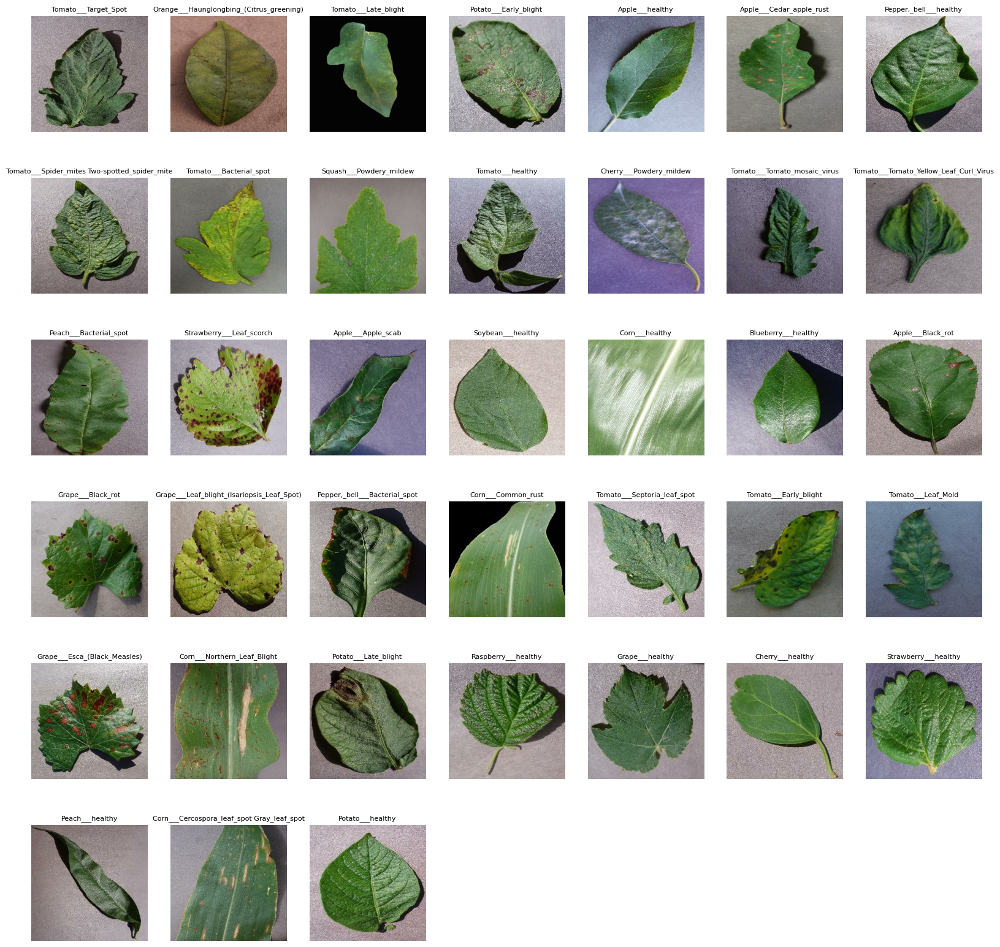

In [7]:
## Image for all categories

# Load the PlantVillage dataset
dataset, info = tfds.load('plant_village', with_info=True, as_supervised=True)

# Extract the dataset
dataset = dataset['train']

# Function to preprocess images
def preprocess(image, label):
    image = tf.image.resize(image, [256, 256])
    image = image / 255.0  # Normalize the pixel values
    return image, label

# Apply preprocessing to the dataset
dataset = dataset.map(preprocess)

# Get one example per class
unique_labels = set()
samples = []

for image, label in dataset:
    label_str = info.features['label'].int2str(label.numpy())
    if label_str not in unique_labels:
        unique_labels.add(label_str)
        samples.append((image, label_str))
    if len(unique_labels) == info.features['label'].num_classes:
        break

# Display images for all categories
num_classes = len(samples)
plt.figure(figsize=(20, 20))
for i, (image, label) in enumerate(samples):
    ax = plt.subplot(6, 7, i + 1)  # Adjust the grid size if needed
    plt.imshow(image.numpy())
    plt.title(label, fontsize = 8)
    plt.axis('off')
plt.show()


In [8]:
# Check for duplicates

# Function to convert image to a hashable form
def image_to_hash(image):
    """Converts image tensor to a hashable representation by reducing its precision and flattening."""
    image_reduced = tf.image.resize(image, [64, 64])  # Reduce resolution to speed up hashing
    image_uint8 = tf.cast(image_reduced * 255, tf.uint8)  # Convert to uint8 to reduce data size
    return hash(image_uint8.numpy().tobytes())

# Assuming 'samples' is the list of (image, label) tuples collected earlier
seen_hashes = set()
duplicates = 0
duplicate_samples = []

for image, label in samples:
    image_hash = image_to_hash(image)
    if image_hash in seen_hashes:
        duplicates += 1
        duplicate_samples.append((image, label))  # Optionally store duplicate samples
    else:
        seen_hashes.add(image_hash)

print(f"Found {duplicates} duplicate images among the different classes.")

# Optionally, display duplicate images if any were found
if duplicates > 0:
    print("Displaying duplicate images:")
    plt.figure(figsize=(10, 10))
    for i, (image, label) in enumerate(duplicate_samples):
        ax = plt.subplot(1, len(duplicate_samples), i + 1)  # Adjust the grid size if needed
        plt.imshow(image.numpy())
        plt.title(label)
        plt.axis('off')
    plt.show()
else:
    print("No duplicate images found.")


Found 0 duplicate images among the different classes.
No duplicate images found.


Dataset Summary

Total number of images: 54303
Total number of categories: 38

Class distribution:

                                            Class  Count
0                            Tomato___Target_Spot   1404
1        Orange___Haunglongbing_(Citrus_greening)   5507
2                            Tomato___Late_blight   1908
3                           Potato___Early_blight   1000
4                                 Apple___healthy   1645
5                        Apple___Cedar_apple_rust    275
6                          Pepper,_bell___healthy   1477
7   Tomato___Spider_mites Two-spotted_spider_mite   1676
8                         Tomato___Bacterial_spot   2127
9                         Squash___Powdery_mildew   1835
10                               Tomato___healthy   1591
11                        Cherry___Powdery_mildew   1052
12                   Tomato___Tomato_mosaic_virus    373
13         Tomato___Tomato_Yellow_Leaf_Curl_Virus   5357
14                         Peach___Bacterial_spot   2297
15   

<Figure size 1200x800 with 0 Axes>

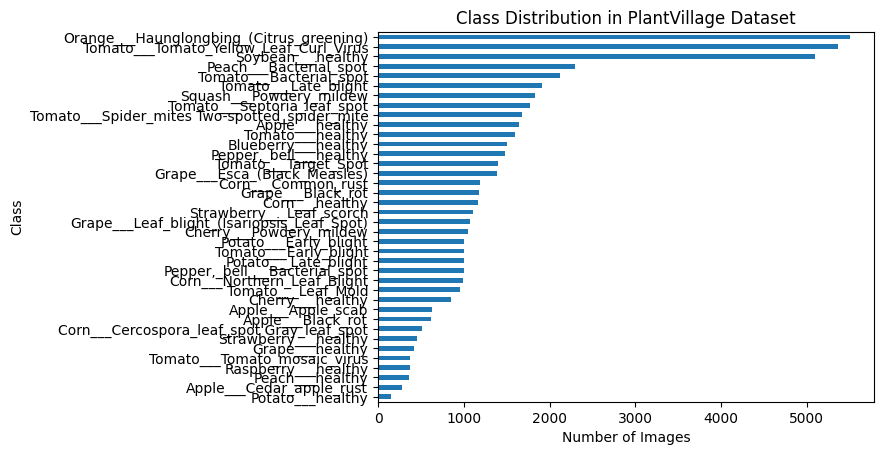

In [9]:
# Load the PlantVillage dataset
dataset, info = tfds.load('plant_village', with_info=True, as_supervised=True)

# Extract the dataset
dataset = dataset['train']

# Initialize counters and a dictionary to store class information
class_counts = {}
total_images = 0

# Iterate through the dataset to count the occurrences of each class
for image, label in dataset:
    label_str = info.features['label'].int2str(label.numpy())
    if label_str not in class_counts:
        class_counts[label_str] = 0
    class_counts[label_str] += 1
    total_images += 1

# Convert the class counts to a DataFrame for better visualization
class_counts_df = pd.DataFrame(list(class_counts.items()), columns=['Class', 'Count'])

# Print summary information
print(f"Total number of images: {total_images}")
print(f"Total number of categories: {len(class_counts)}")
print("\nClass distribution:\n")
print(class_counts_df)

# Display class distribution
import matplotlib.pyplot as plt

plt.figure(figsize=(12, 8))
class_counts_df.set_index('Class').sort_values('Count').plot(kind='barh', legend=False)
plt.title('Class Distribution in PlantVillage Dataset')
plt.xlabel('Number of Images')
plt.ylabel('Class')
plt.show()


In [10]:
# Additional Summary healthy/unhealthy and Null

# Load the PlantVillage dataset
dataset, info = tfds.load('plant_village', with_info=True, as_supervised=True)

# Extract the dataset
dataset = dataset['train']

# Initialize counters and a dictionary to store class information
crop_health_counts = {}
total_images = 0
null_image_count = 0
null_label_count = 0

# Iterate through the dataset to count the occurrences of each class
for image, label in dataset:
    if image is None:
        null_image_count += 1
        continue
    if label is None:
        null_label_count += 1
        continue

    label_str = info.features['label'].int2str(label.numpy())
    crop_name, health_status = label_str.split("___")
    if crop_name not in crop_health_counts:
        crop_health_counts[crop_name] = {"healthy": 0, "unhealthy": 0}
    if health_status == "healthy":
        crop_health_counts[crop_name]["healthy"] += 1
    else:
        crop_health_counts[crop_name]["unhealthy"] += 1
    total_images += 1

# Convert the crop health counts to a DataFrame for better visualization
crop_health_counts_df = pd.DataFrame(crop_health_counts).T
crop_health_counts_df = crop_health_counts_df.reset_index().rename(columns={"index": "Crop"})
crop_health_counts_df["total"] = crop_health_counts_df["healthy"] + crop_health_counts_df["unhealthy"]

# Print summary information
print(f"Total number of images: {total_images}")
print(f"Total number of crops: {len(crop_health_counts)}")
print(f"Number of null images: {null_image_count}")
print(f"Number of null labels: {null_label_count}")
print("\nHealthy/Unhealthy split for each crop:\n")
print(crop_health_counts_df)


Total number of images: 54303
Total number of crops: 14
Number of null images: 0
Number of null labels: 0

Healthy/Unhealthy split for each crop:

            Crop  healthy  unhealthy  total
0         Tomato     1591      16568  18159
1         Orange        0       5507   5507
2         Potato      152       2000   2152
3          Apple     1645       1526   3171
4   Pepper,_bell     1477        997   2474
5         Squash        0       1835   1835
6         Cherry      854       1052   1906
7          Peach      360       2297   2657
8     Strawberry      456       1109   1565
9        Soybean     5090          0   5090
10          Corn     1162       2690   3852
11     Blueberry     1502          0   1502
12         Grape      423       3639   4062
13     Raspberry      371          0    371


In [11]:
# Load the PlantVillage dataset
dataset, info = tfds.load('plant_village', with_info=True, as_supervised=True)

# Extract the dataset
dataset = dataset['train']

# Initialize counters and a dictionary to store class information
crop_health_counts = {}
total_images = 0

# Iterate through the dataset to count the occurrences of each class
for image, label in dataset:
    label_str = info.features['label'].int2str(label.numpy())
    crop_name, health_status = label_str.split("___")
    if crop_name not in crop_health_counts:
        crop_health_counts[crop_name] = {"healthy": 0, "unhealthy": 0}
    if health_status == "healthy":
        crop_health_counts[crop_name]["healthy"] += 1
    else:
        crop_health_counts[crop_name]["unhealthy"] += 1
    total_images += 1

# Convert the crop health counts to a DataFrame for better visualization
crop_health_counts_df = pd.DataFrame(crop_health_counts).T
crop_health_counts_df = crop_health_counts_df.reset_index().rename(columns={"index": "Crop"})
crop_health_counts_df["total"] = crop_health_counts_df["healthy"] + crop_health_counts_df["unhealthy"]

# Create a nicely formatted table using tabulate
table = tabulate(crop_health_counts_df, headers='keys', tablefmt='grid')

# Print the formatted table
print(table)


+----+--------------+-----------+-------------+---------+
|    | Crop         |   healthy |   unhealthy |   total |
+====+==============+===========+=============+=========+
|  0 | Tomato       |      1591 |       16568 |   18159 |
+----+--------------+-----------+-------------+---------+
|  1 | Orange       |         0 |        5507 |    5507 |
+----+--------------+-----------+-------------+---------+
|  2 | Potato       |       152 |        2000 |    2152 |
+----+--------------+-----------+-------------+---------+
|  3 | Apple        |      1645 |        1526 |    3171 |
+----+--------------+-----------+-------------+---------+
|  4 | Pepper,_bell |      1477 |         997 |    2474 |
+----+--------------+-----------+-------------+---------+
|  5 | Squash       |         0 |        1835 |    1835 |
+----+--------------+-----------+-------------+---------+
|  6 | Cherry       |       854 |        1052 |    1906 |
+----+--------------+-----------+-------------+---------+
|  7 | Peach  

In [12]:
# Size and number of channels

# Collect unique dimensions
unique_dimensions = set()

for image, label in dataset:
    unique_dimensions.add(image.shape)

# Display information about the dataset
print("Reported image shape from metadata:", info.features['image'].shape)

# Display unique dimensions collected
print("Unique image dimensions in the dataset:", unique_dimensions)


Reported image shape from metadata: (None, None, 3)
Unique image dimensions in the dataset: {TensorShape([256, 256, 3])}


In [13]:
# Create table with disease names

# Load the PlantVillage dataset with metadata (assuming it's already loaded in your case)
dataset, info = tfds.load('plant_village', with_info=True, as_supervised=True)

# Extract label names
label_names = info.features['label'].names

# Create a DataFrame from the label names
df_labels = pd.DataFrame(label_names, columns=['Label Names'])

# Print the DataFrame using tabulate for a nice table format
print(tabulate(df_labels, headers='keys', tablefmt='psql', showindex=False))


+-----------------------------------------------+
| Label Names                                   |
|-----------------------------------------------|
| Apple___Apple_scab                            |
| Apple___Black_rot                             |
| Apple___Cedar_apple_rust                      |
| Apple___healthy                               |
| Blueberry___healthy                           |
| Cherry___healthy                              |
| Cherry___Powdery_mildew                       |
| Corn___Cercospora_leaf_spot Gray_leaf_spot    |
| Corn___Common_rust                            |
| Corn___healthy                                |
| Corn___Northern_Leaf_Blight                   |
| Grape___Black_rot                             |
| Grape___Esca_(Black_Measles)                  |
| Grape___healthy                               |
| Grape___Leaf_blight_(Isariopsis_Leaf_Spot)    |
| Orange___Haunglongbing_(Citrus_greening)      |
| Peach___Bacterial_spot                        |


In [14]:
# Table with crop name, healthy/unhealthy and disease name

# Sample data based on your label format
labels = [
    'Apple___Apple_scab', 'Apple___Black_rot', 'Apple___Cedar_apple_rust',
    'Apple___healthy', 'Blueberry___healthy', 'Cherry___healthy',
    'Cherry___Powdery_mildew', 'Corn___Cercospora_leaf_spot Gray_leaf_spot',
    'Corn___Common_rust', 'Corn___healthy', 'Corn___Northern_Leaf_Blight',
    'Grape___Black_rot', 'Grape___Esca_(Black_Measles)', 'Grape___healthy',
    'Grape___Leaf_blight_(Isariopsis_Leaf_Spot)', 'Orange___Haunglongbing_(Citrus_greening)',
    'Peach___Bacterial_spot', 'Peach___healthy', 'Pepper,_bell___Bacterial_spot',
    'Pepper,_bell___healthy', 'Potato___Early_blight', 'Potato___healthy',
    'Potato___Late_blight', 'Raspberry___healthy', 'Soybean___healthy',
    'Squash___Powdery_mildew', 'Strawberry___healthy', 'Strawberry___Leaf_scorch',
    'Tomato___Bacterial_spot', 'Tomato___Early_blight', 'Tomato___healthy',
    'Tomato___Late_blight', 'Tomato___Leaf_Mold', 'Tomato___Septoria_leaf_spot',
    'Tomato___Spider_mites Two-spotted_spider_mite', 'Tomato___Target_Spot',
    'Tomato___Tomato_mosaic_virus', 'Tomato___Tomato_Yellow_Leaf_Curl_Virus'
]

# Create a DataFrame to hold the data
df = pd.DataFrame(columns=['Crop', 'Health_Status', 'Features'])

# Populate the DataFrame using concat instead of append
for label in labels:
    parts = label.split("___")
    crop = parts[0]
    if 'healthy' in parts[1]:
        health_status = 'Healthy'
        features = 'None'
    else:
        health_status = 'Unhealthy'
        features = parts[1]

    # Create a new DataFrame for the current row and concatenate it to the main DataFrame
    new_row = pd.DataFrame({'Crop': [crop], 'Health_Status': [health_status], 'Features': [features]})
    df = pd.concat([df, new_row], ignore_index=True)

# Display the DataFrame
#print(df)
df


,Crop,Health_Status,Features
0,Apple,Unhealthy,Apple_scab
1,Apple,Unhealthy,Black_rot
2,Apple,Unhealthy,Cedar_apple_rust
3,Apple,Healthy,None
4,Blueberry,Healthy,None
5,Cherry,Healthy,None
6,Cherry,Unhealthy,Powdery_mildew
7,Corn,Unhealthy,Cercospora_leaf_spot Gray_leaf_spot
8,Corn,Unhealthy,Common_rust
9,Corn,Healthy,None


# Tomato Dataset

## Tomato EDA

In [15]:
# Load the PlantVillage dataset
dataset, info = tfds.load('plant_village', with_info=True, as_supervised=True)

# Assuming 'train' is the correct split; adjust as necessary based on 'info.splits'
train_dataset = dataset['train']  # Correctly access the 'train'

def preprocess_and_filter(image, label):
    # Resize and normalize the image
    image = tf.image.resize(image, [256, 256])
    image = image / 255.0
    # Decode the label into a string
    label_str = info.features['label'].int2str(label.numpy())
    # Check if the label denotes a tomato
    is_tomato = tf.strings.regex_full_match(label_str, ".*Tomato.*")
    return is_tomato, image, label_str

def apply_preprocess_and_filter(image, label):
    return tf.py_function(preprocess_and_filter, [image, label], [tf.bool, tf.float32, tf.string])

def filter_tomato(is_tomato, image, label):
    return is_tomato

def map_to_image_label(is_tomato, image, label):
    return image, label

# Apply preprocessing and filtering to the dataset
processed_dataset = train_dataset.map(apply_preprocess_and_filter, num_parallel_calls=tf.data.experimental.AUTOTUNE)
tomato_dataset = processed_dataset.filter(filter_tomato).map(map_to_image_label)


Check size of images for tomato dataset.

In [16]:
# Initialize counters and a dictionary to store class information
class_counts = Counter()
total_images = 0

# Initialize lists to store image resolutions and sizes for Tomato class
tomato_resolutions = []
tomato_image_sizes = []

# Iterate through the dataset to count the occurrences of each class and gather Tomato class data
for image, label in tfds.as_numpy(dataset['train']):
    label_str = info.features['label'].int2str(label)
    class_counts[label_str] += 1
    total_images += 1
    if 'Tomato' in label_str:
        tomato_resolutions.append(image.shape)
        image_size_kb = len(tf.io.encode_jpeg(tf.convert_to_tensor(image)).numpy()) / 1024
        tomato_image_sizes.append(image_size_kb)

# Convert the class counts to a DataFrame for better visualization
class_counts_df = pd.DataFrame(class_counts.items(), columns=['Class', 'Count'])

# Print variation of image sizes (in KB) for images in Tomato class
print("\nVariation of image sizes (in KB) for Tomato class:\n")
print(f"Mean size: {np.mean(tomato_image_sizes):.2f} KB")
print(f"Standard deviation: {np.std(tomato_image_sizes):.2f} KB")
print(f"Minimum size: {np.min(tomato_image_sizes):.2f} KB")
print(f"Maximum size: {np.max(tomato_image_sizes):.2f} KB")



Variation of image sizes (in KB) for Tomato class:

Mean size: 29.83 KB
Standard deviation: 9.66 KB
Minimum size: 5.07 KB
Maximum size: 54.05 KB


### Tomato Dataset Preprocessing

#### Normalization

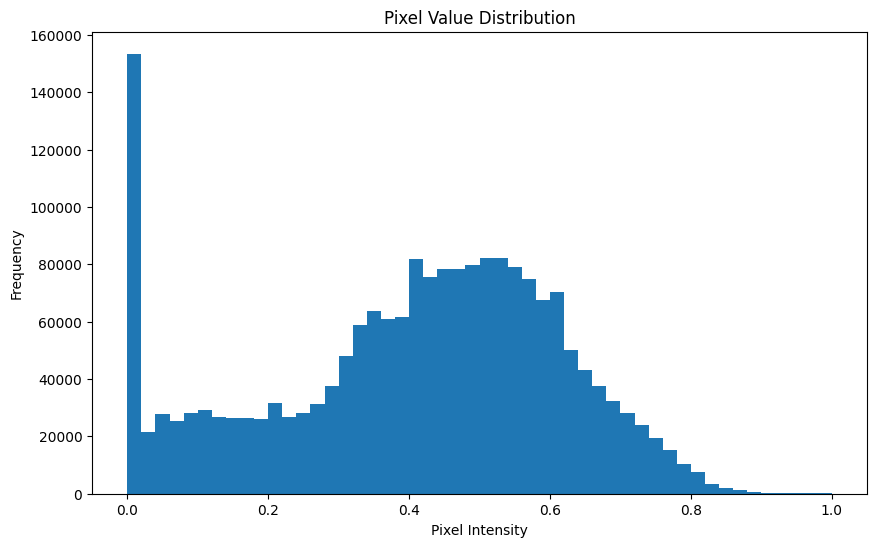

In [17]:
# Check Resize and normalization
def plot_pixel_distribution(dataset, sample_size=10):
    pixel_values = []
    for image, _ in dataset.take(sample_size):
        pixel_values.extend(image.numpy().flatten())

    plt.figure(figsize=(10, 6))
    plt.hist(pixel_values, bins=50, range=(0, 1))
    plt.title('Pixel Value Distribution')
    plt.xlabel('Pixel Intensity')
    plt.ylabel('Frequency')
    plt.show()

# Plotting the pixel value distribution for a sample of images
plot_pixel_distribution(tomato_dataset)


In [18]:
# Tomato dataset properties.
def check_dataset_properties(dataset):
    for image, label in dataset.take(10):  # Check 10 images as a sample
        # Check image size
        assert image.shape == (256, 256, 3), f"Image shape mismatch: {image.shape}"
        # Check normalization
        assert tf.reduce_min(image) >= 0.0 and tf.reduce_max(image) <= 1.0, "Image not normalized"
        print(f"Checked image with label: {label.numpy().decode('utf-8')} - Size: {image.shape}, Min pixel value: {tf.reduce_min(image)}, Max pixel value: {tf.reduce_max(image)}")

# Run the checks
check_dataset_properties(tomato_dataset)


Checked image with label: Tomato___Target_Spot - Size: (256, 256, 3), Min pixel value: 0.0, Max pixel value: 1.0
Checked image with label: Tomato___Late_blight - Size: (256, 256, 3), Min pixel value: 0.0, Max pixel value: 0.9647058844566345
Checked image with label: Tomato___Spider_mites Two-spotted_spider_mite - Size: (256, 256, 3), Min pixel value: 0.0, Max pixel value: 1.0
Checked image with label: Tomato___Bacterial_spot - Size: (256, 256, 3), Min pixel value: 0.0, Max pixel value: 0.8313725590705872
Checked image with label: Tomato___Late_blight - Size: (256, 256, 3), Min pixel value: 0.0, Max pixel value: 0.9921568632125854
Checked image with label: Tomato___healthy - Size: (256, 256, 3), Min pixel value: 0.0, Max pixel value: 1.0
Checked image with label: Tomato___Spider_mites Two-spotted_spider_mite - Size: (256, 256, 3), Min pixel value: 0.0, Max pixel value: 1.0
Checked image with label: Tomato___Tomato_mosaic_virus - Size: (256, 256, 3), Min pixel value: 0.0, Max pixel value

#### Tomato's categories

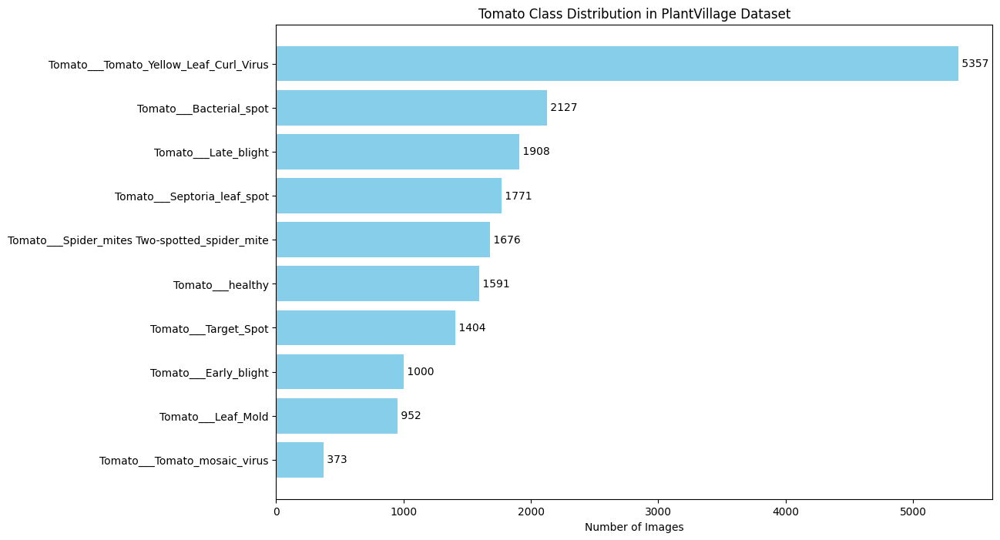

In [19]:
# Apply your preprocessing, filtering, and mapping functions
processed_dataset = dataset['train'].map(apply_preprocess_and_filter, num_parallel_calls=tf.data.experimental.AUTOTUNE)
tomato_dataset = processed_dataset.filter(filter_tomato).map(map_to_image_label)

# Collect labels
labels = []

# Iterate through the tomato_dataset to collect labels
for image, label in tomato_dataset:
    labels.append(label.numpy().decode('utf-8'))

# Count the occurrences of each label
label_counts = Counter(labels)

# Data for plotting
classes = list(label_counts.keys())
counts = list(label_counts.values())

# Sort classes by counts (optional)
sorted_classes = sorted(label_counts.items(), key=lambda x: x[1], reverse=True)
classes, counts = zip(*sorted_classes)  # Unzip the sorted items

# Creating a horizontal bar chart for better readability
plt.figure(figsize=(12, 8))
bars = plt.barh(classes, counts, color='skyblue')  # Horizontal bar chart
plt.xlabel('Number of Images')
plt.title('Tomato Class Distribution in PlantVillage Dataset')

# Adding text labels to each bar
for bar, count in zip(bars, counts):
    plt.text(bar.get_width(), bar.get_y() + bar.get_height()/2, f' {count}', va='center')

plt.gca().invert_yaxis()  # Invert y-axis to have the highest counts at the top
plt.show()


#### Images for each tomato's categories.

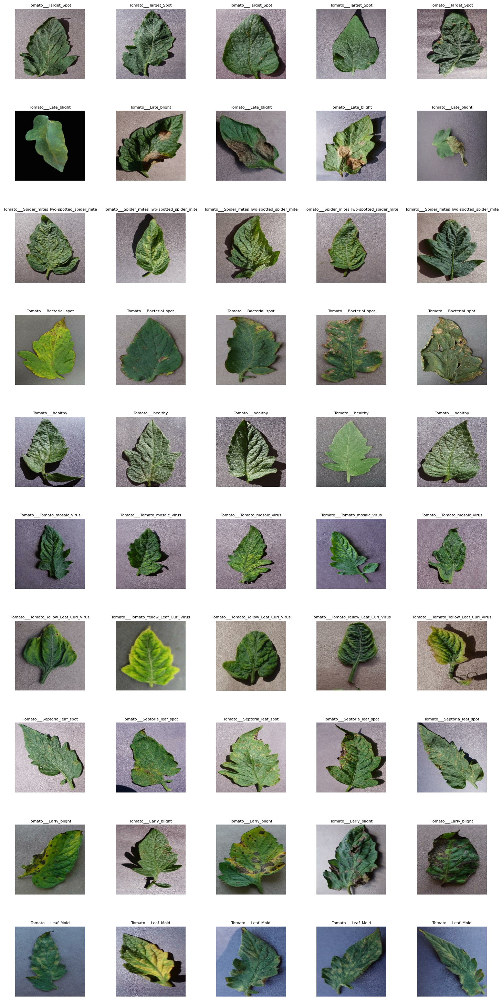

In [20]:
# Function to collect samples
def collect_samples(dataset, num_samples_per_class):
    samples_per_class = {}
    for image, label in dataset:
        label = label.numpy().decode('utf-8')  # Ensure label is a string
        if label not in samples_per_class:
            samples_per_class[label] = [image.numpy()]
        elif len(samples_per_class[label]) < num_samples_per_class:
            samples_per_class[label].append(image.numpy())

        # Check if we have enough samples for all classes
        if all(len(samples) >= num_samples_per_class for samples in samples_per_class.values()):
            break
    return samples_per_class

# Collect at least 5 images for each category of tomato diseases
num_samples_per_class = 5
tomato_samples = collect_samples(tomato_dataset, num_samples_per_class)

# Plot the samples
fig, axs = plt.subplots(len(tomato_samples), num_samples_per_class, figsize=(15, len(tomato_samples) * 3))
fig.tight_layout(pad=3.0)

title_font_size = 10  # You can adjust the font size here

for i, (label, images) in enumerate(tomato_samples.items()):
    for j, image in enumerate(images):
        axs[i, j].imshow(image)
        axs[i, j].axis('off')
        axs[i, j].set_title(label, fontsize=8)  # Set title for each image
    axs[i, 0].set_ylabel(label, rotation=0, size='large', labelpad=30)

plt.show()


Display a few random tomato's images.

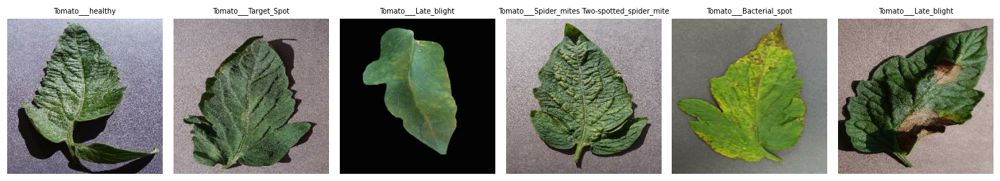

In [21]:
# Print Tomato images

# Collect examples
healthy_tomatoes = []
unhealthy_tomatoes = []

for image, label in tomato_dataset.take(10):
    label = label.numpy().decode('utf-8')
    if 'healthy' in label and len(healthy_tomatoes) < 5:
        healthy_tomatoes.append((image.numpy(), label))
    elif 'healthy' not in label and len(unhealthy_tomatoes) < 5:
        unhealthy_tomatoes.append((image.numpy(), label))

# Display the images
plt.figure(figsize=(14, 14))
for i, (image, label) in enumerate(healthy_tomatoes + unhealthy_tomatoes):
    ax = plt.subplot(2, 6, i + 1)
    plt.imshow(image)
    plt.title(label, fontsize = 7)
    plt.axis('off')
plt.tight_layout() # Ensure there is space for title
plt.show()


#### Grayscale

Grayscale for all tomato' categories, maintaining RGB format.

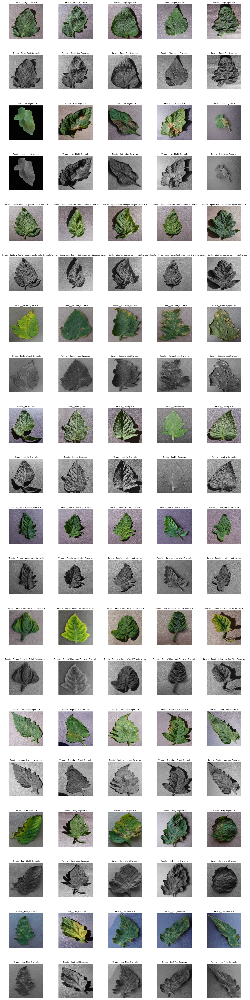

In [22]:
# Function to collect samples
def collect_samples(dataset, num_samples_per_class):
    samples_per_class = {}
    for image, label in dataset:
        label = label.numpy().decode('utf-8')  # Ensure label is a string
        image = image.numpy()
        # Convert image to grayscale and maintain RGB format
        gray_image = np.mean(image, axis=-1, keepdims=True)  # Compute mean across color channels
        gray_image_rgb = np.concatenate([gray_image] * 3, axis=-1)  # Replicate grayscale across 3 channels

        if label not in samples_per_class:
            samples_per_class[label] = {'rgb': [image], 'gray': [gray_image_rgb]}
        else:
            if len(samples_per_class[label]['rgb']) < num_samples_per_class:
                samples_per_class[label]['rgb'].append(image)
                samples_per_class[label]['gray'].append(gray_image_rgb)

        # Check if we have enough samples for all classes
        if all(len(samples['rgb']) >= num_samples_per_class for samples in samples_per_class.values()):
            break
    return samples_per_class

# Collect at least 5 images for each category of tomato diseases
num_samples_per_class = 5
tomato_samples = collect_samples(tomato_dataset, num_samples_per_class)

# Plot the samples
fig, axs = plt.subplots(len(tomato_samples) * 2, num_samples_per_class, figsize=(15, len(tomato_samples) * 6))  # Increase figure size for better visibility
fig.tight_layout(pad=3.0)

title_font_size = 10  # To adjust the font size

for i, (label, images) in enumerate(tomato_samples.items()):
    for j in range(num_samples_per_class):
        # Plot RGB images
        axs[2 * i, j].imshow(images['rgb'][j])
        axs[2 * i, j].axis('off')
        axs[2 * i, j].set_title(f"{label} RGB", fontsize=7)

        # Plot grayscale images
        axs[2 * i + 1, j].imshow(images['gray'][j], cmap='gray')
        axs[2 * i + 1, j].axis('off')
        axs[2 * i + 1, j].set_title(f"{label} Grayscale", fontsize=7)

plt.show()


TBD - Using grayscale does not seem a good approach because  the specific color variations associated with different plant health conditions are obscured, as shown in the image above. We would then use color augmentation and color threesholding.-

*Color augmentation* enhances color features by adjusting image properties such as saturation, brightness, and contrast. This can help highlight subtle color differences that indicate disease.

*Color thresholding* can help isolate areas of an image that fall within specific color ranges which might be indicative of disease. This because some diseases might be identified by particular color ranges.

We then re-load the PlantVillage dataset, ensure images size is 256x256 and normalize images.

#### Gaussian Filter - denoising

In [23]:
# Create function for Gaussian filter
def apply_gaussian_blur(image, label):
    # Apply a Gaussian blur to the image
    blur_image = tfa.image.gaussian_filter2d(
        image,
        filter_shape=(5, 5),  # size of the Gaussian filter
        sigma=1)           # standard deviation of the Gaussian filter
    return blur_image, label

# Apply the Gaussian blur to the dataset
blurred_tomato_dataset = tomato_dataset.map(apply_gaussian_blur)

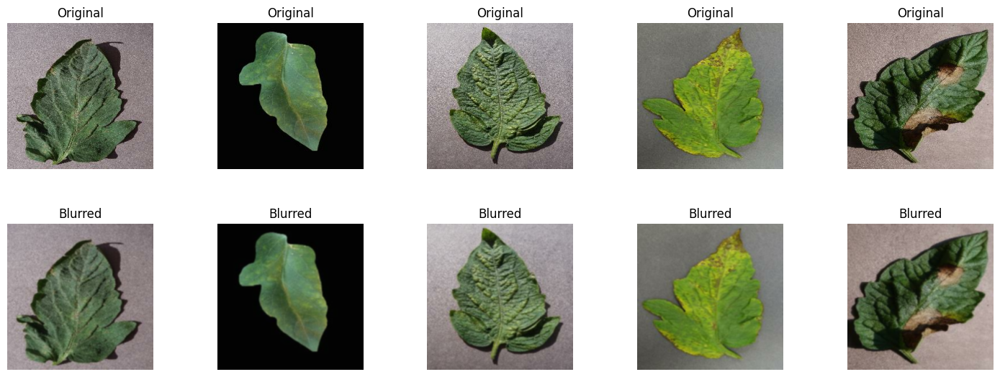

In [24]:
# Visualizing effect of Gaussian filter

# Take a few samples from the dataset to display
original_and_blurred = blurred_tomato_dataset.take(5)

# Plotting the comparison
fig, axs = plt.subplots(2, 5, figsize=(15, 6))
fig.tight_layout(pad=3.0)

for i, ((original_image, _), (blurred_image, label)) in enumerate(zip(tomato_dataset.take(5), original_and_blurred)):
    axs[0, i].imshow(original_image.numpy())
    axs[0, i].set_title("Original")
    axs[0, i].axis('off')

    axs[1, i].imshow(blurred_image.numpy())
    axs[1, i].set_title("Blurred")
    axs[1, i].axis('off')

plt.show()

OUTCOME:

Gaussian filter is not beneficial. Disease identification can be dependent on color variations and tecxture detail beside shapes and structures in images. From outcomes, also adjusting 'filter shape' (which define the size of the Gaussian filter, with larger sizes leading result in more blurring) and 'sigma" (which controls the standard deviation of the Gaussian kernel, where a higher sigma value increases the spread of the blur), we found that uisng this preprocessing technique was not beneficial, see images above.

#### Rotation

Same leaves are not vertically aligned. We need to rotate them but that mean loosing RGB format.

SEE MANA NOTEBOOK

### Simple Features Extraction

#### Reload dataset

In [38]:
# Load the PlantVillage dataset
dataset, info = tfds.load('plant_village', with_info=True, as_supervised=True)

# Assuming 'train' is the correct split; adjust as necessary based on 'info.splits'
train_dataset = dataset['train']  # Correctly access the 'train'

def preprocess_and_filter(image, label):
    # Resize and normalize the image
    image = tf.image.resize(image, [256, 256])
    image = image / 255.0
    # Decode the label into a string
    label_str = info.features['label'].int2str(label.numpy())
    # Check if the label denotes a tomato
    is_tomato = tf.strings.regex_full_match(label_str, ".*Tomato.*")
    return is_tomato, image, label_str

def apply_preprocess_and_filter(image, label):
    return tf.py_function(preprocess_and_filter, [image, label], [tf.bool, tf.float32, tf.string])

def filter_tomato(is_tomato, image, label):
    return is_tomato

def map_to_image_label(is_tomato, image, label):
    return image, label

# Apply preprocessing and filtering to the dataset
processed_dataset = train_dataset.map(apply_preprocess_and_filter, num_parallel_calls=tf.data.experimental.AUTOTUNE)
tomato_dataset = processed_dataset.filter(filter_tomato).map(map_to_image_label)


In [39]:
import tensorflow as tf

# Define a function to display image properties
def display_image_properties(dataset):
    for image, label in dataset.take(1):  # Take only one sample from the dataset
        print("Image shape:", image.shape)
        print("Image dtype:", image.dtype)
        print("Label:", label.numpy().decode('utf-8'))

# Apply the function to the tomato dataset
display_image_properties(tomato_dataset)

Image shape: (256, 256, 3)
Image dtype: <dtype: 'float32'>
Label: Tomato___Target_Spot


In [40]:
def check_images_format(dataset):
    for images, labels in dataset.take(1):  # Take one batch from the dataset
        print("Batch shape:", images.shape)
        print("Data type:", images.dtype)
        # Ensure there are 4 dimensions [batch_size, height, width, channels]
        if images.ndim == 4 and images.shape[-1] == 3:
            print("Images are in the correct RGB format.")
        else:
            print("Images are NOT in the correct RGB format.")

# Check the format of images in the dataset
check_images_format(tomato_dataset.batch(5))  # Ensure batching here


Batch shape: (5, 256, 256, 3)
Data type: <dtype: 'float32'>
Images are in the correct RGB format.


#### Color Histogram

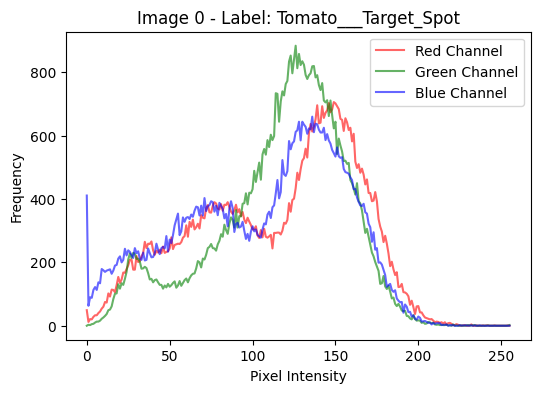

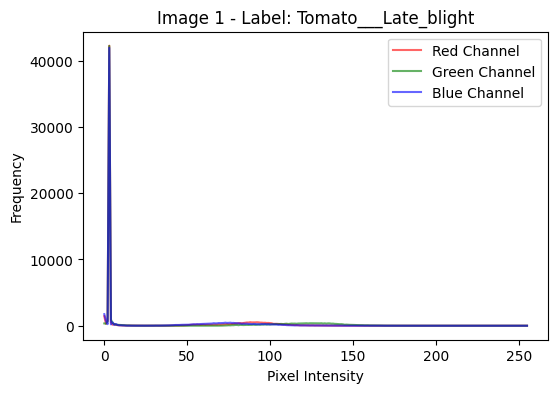

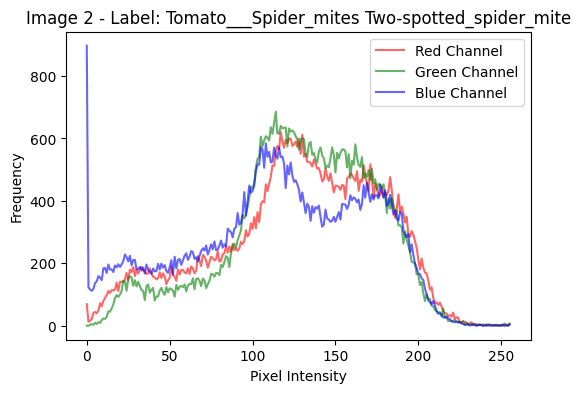

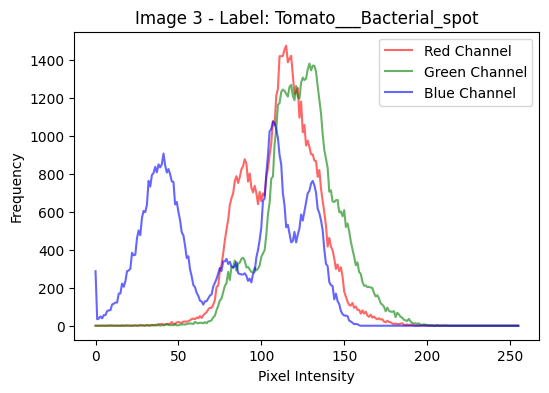

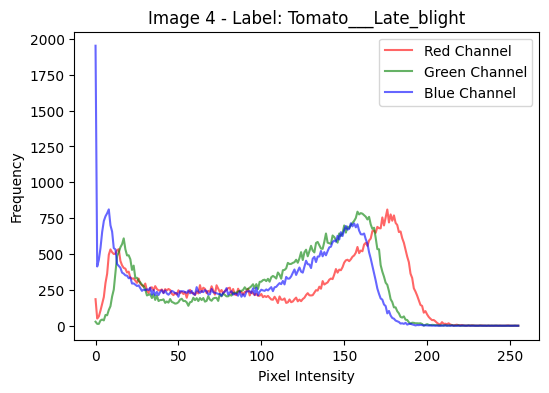

In [41]:
# it takes 3 minutes to run
import tensorflow as tf
import tensorflow_datasets as tfds
import matplotlib.pyplot as plt
import numpy as np

# A list to store histogram data
histogram_data = []

def calculate_histogram(image):
    image = image.numpy()  # Convert Tensor to NumPy array
    histograms = []

    for i in range(3):  # For RGB channels
        histogram, _ = np.histogram(image[:, :, i], bins=256, range=(0, 1))
        histograms.append(histogram)

    return histograms

def process_all_images(dataset):
    global histogram_data
    histogram_data = []
    for index, (image, label) in enumerate(dataset):
        histograms = calculate_histogram(image)
        label_str = label.numpy().decode('utf-8') if isinstance(label.numpy(), bytes) else str(label.numpy())
        histogram_data.append((index, histograms, label_str))

def plot_combined_histogram(histograms, label, index):
    colors = ('Red', 'Green', 'Blue')
    channels = ('r', 'g', 'b')

    plt.figure(figsize=(6, 4))

    for i, color in enumerate(colors):
        plt.plot(np.arange(256), histograms[i], color=channels[i], alpha=0.6, label=f'{color} Channel')

    plt.title(f"Image {index} - Label: {label}")
    plt.xlabel("Pixel Intensity")
    plt.ylabel("Frequency")
    plt.legend()
    plt.show()

def display_subset_histograms(num_examples=5):
    for i in range(min(num_examples, len(histogram_data))):
        index, histograms, label = histogram_data[i]
        plot_combined_histogram(histograms, label, index)

# Process all images in the tomato dataset and store histogram data
process_all_images(tomato_dataset)

# Display histograms for a subset of images
display_subset_histograms(5)

#### Color based segmentation

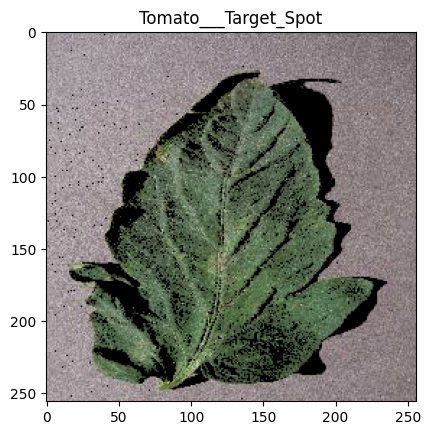

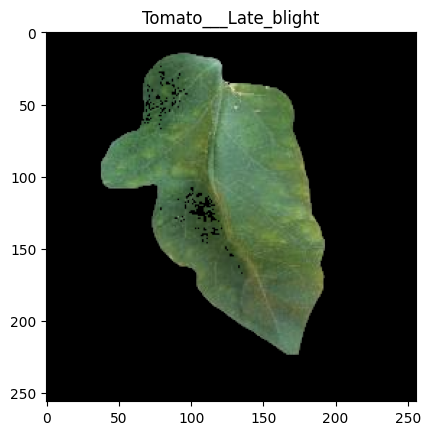

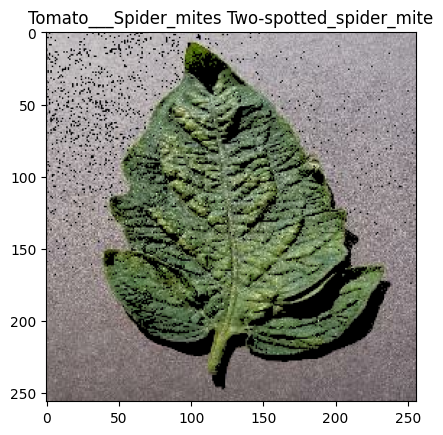

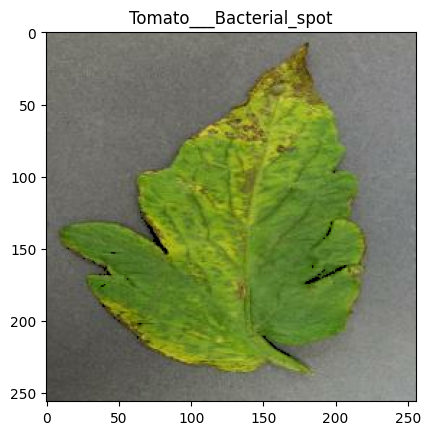

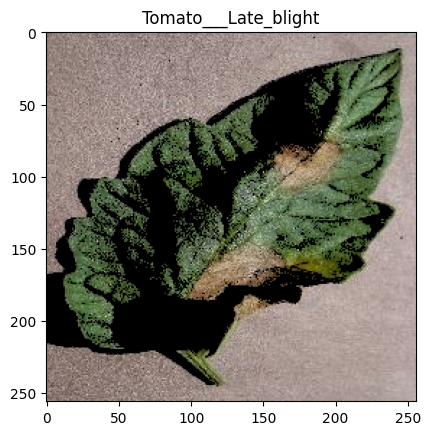

In [42]:
import tensorflow as tf

# Define additional augmentation functions
def color_augment(image, label):
    image = tf.image.random_brightness(image, max_delta=0.1)
    image = tf.image.random_contrast(image, lower=0.9, upper=1.4)
    image = tf.image.random_saturation(image, lower=0.9, upper=1.4)
    image = tf.clip_by_value(image, 0.0, 1.0)
    return image, label

def color_based_segmentation(image, lower_bound, upper_bound):
    # Normalize the image to [0, 1] if it's not already
    if tf.reduce_max(image) > 1.0:
        image = image / 255.0
    # Create a boolean mask where true values correspond to pixels within the bounds
    mask = tf.reduce_all(tf.logical_and(lower_bound <= image, image <= upper_bound), axis=-1)
    # Apply the mask to the image, setting non-masked areas to black
    segmented_image = tf.where(mask[..., tf.newaxis], image, tf.zeros_like(image))
    return segmented_image

def apply_segmentation(image, label):
    # Define lower and upper bounds for color thresholding
    lower_bound = tf.constant([0.2, 0.2, 0.0], dtype=tf.float32)  # Adjusted for red and yellow tones
    upper_bound = tf.constant([1.0, 1.0, 0.8], dtype=tf.float32)  # Upper limit for blue reduced
    # Segment the image using the color bounds
    segmented_image = color_based_segmentation(image, lower_bound, upper_bound)
    return segmented_image, label

# Assuming the rest of your dataset processing and application code is correct

# Display segmented images for a subset of examples
def display_segmented_images(dataset, num_examples=5):
    for images, labels in dataset.take(num_examples):
        plt.imshow(images.numpy())
        plt.title(labels.numpy().decode('utf-8'))
        plt.show()

# Example usage assuming dataset is properly loaded and preprocessed
segmented_tomato_dataset = tomato_dataset.map(lambda image, label: tf.py_function(apply_segmentation, [image, label], [tf.float32, tf.string]))
display_segmented_images(segmented_tomato_dataset)

#### Edge Detection (Sobel)

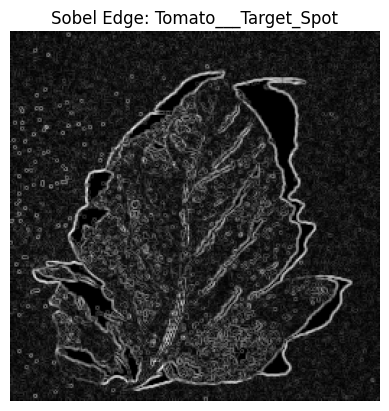

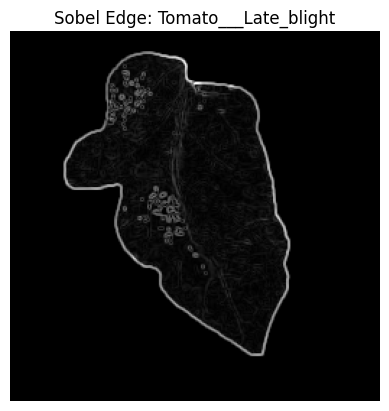

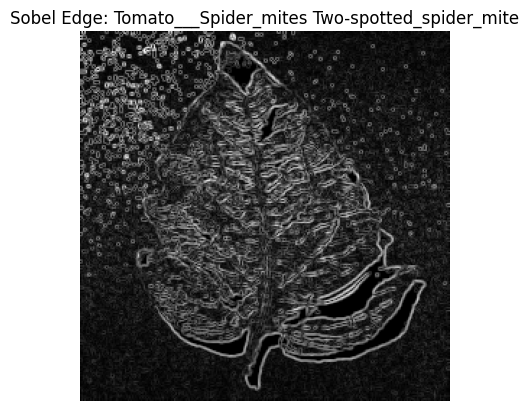

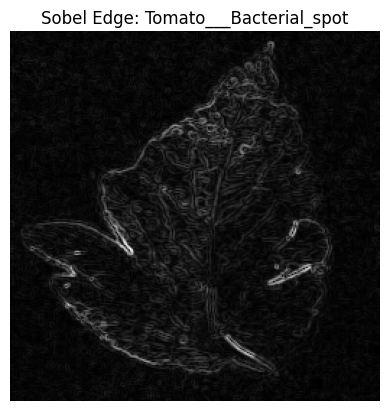

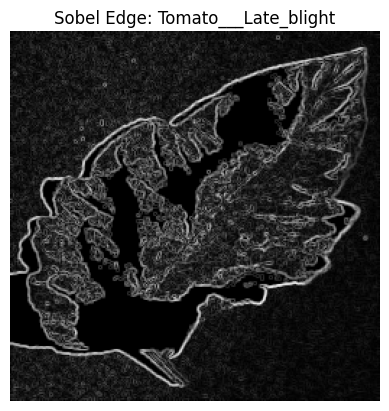

In [43]:
import tensorflow as tf
import tensorflow_datasets as tfds
import matplotlib.pyplot as plt
import numpy as np

# Function to preprocess images
def preprocess_image(image, label):
    # Resize and normalize the image
    image = tf.image.resize(image, [256, 256])
    image = image / 255.0
    return image, label

# Function to preprocess and filter tomato images
def preprocess_and_filter(image, label):
    image, label = preprocess_image(image, label)
    label_str = info.features['label'].int2str(label.numpy())
    is_tomato = tf.strings.regex_full_match(label_str, ".*Tomato.*")
    return is_tomato, image, label_str

def apply_preprocess_and_filter(image, label):
    return tf.py_function(preprocess_and_filter, [image, label], [tf.bool, tf.float32, tf.string])

def filter_tomato(is_tomato, image, label):
    return is_tomato

def map_to_image_label(is_tomato, image, label):
    return image, label

# Define additional augmentation functions
def color_augment(image, label):
    image = tf.image.random_brightness(image, max_delta=0.1)
    image = tf.image.random_contrast(image, lower=0.9, upper=1.4)
    image = tf.image.random_saturation(image, lower=0.9, upper=1.4)
    image = tf.clip_by_value(image, 0.0, 1.0)
    return image, label

# Function to apply color-based segmentation and mask out the background
def color_based_segmentation(image, lower_bound, upper_bound):
    mask = tf.reduce_all(tf.logical_and(lower_bound <= image, image <= upper_bound), axis=-1)
    segmented_image = tf.where(mask[..., tf.newaxis], image, tf.zeros_like(image))  # Keep segmented parts, set background to black
    return segmented_image

def apply_segmentation(image, label):
    lower_bound = tf.constant([0.2, 0.2, 0.0], dtype=tf.float32)  # Looking for red, yellow, brown
    upper_bound = tf.constant([1.0, 1.0, 0.8], dtype=tf.float32)
    segmented_image = color_based_segmentation(image, lower_bound, upper_bound)
    return segmented_image, label

# Function to apply Sobel edge detection
def apply_sobel_edge_detection(image, label):
    image = tf.image.rgb_to_grayscale(image)
    image = tf.expand_dims(image, axis=0)  # Add batch dimension
    sobel_edges = tf.image.sobel_edges(image)
    sobel_magnitude = tf.sqrt(tf.reduce_sum(tf.square(sobel_edges), axis=-1))
    sobel_magnitude = tf.squeeze(sobel_magnitude, axis=0)  # Remove batch dimension
    sobel_magnitude = tf.squeeze(sobel_magnitude, axis=-1)  # Remove extra dimension
    return sobel_magnitude, label

# Function to display images
def display_images(dataset, num_examples=5, title="Image"):
    for i, (image, label) in enumerate(dataset.take(num_examples)):
        plt.imshow(image.numpy(), cmap='gray')
        plt.title(f"{title}: {label.numpy().decode('utf-8')}")
        plt.axis('off')
        plt.show()

# Load the PlantVillage dataset
dataset, info = tfds.load('plant_village', with_info=True, as_supervised=True)
train_dataset = dataset['train']

# Apply preprocessing and filtering to the dataset
processed_dataset = train_dataset.map(apply_preprocess_and_filter, num_parallel_calls=tf.data.experimental.AUTOTUNE)
tomato_dataset = processed_dataset.filter(filter_tomato).map(map_to_image_label)

# Apply segmentation to the tomato dataset
segmented_tomato_dataset = tomato_dataset.map(lambda image, label: tf.py_function(apply_segmentation, [image, label], [tf.float32, tf.string]))

# Apply Sobel edge detection to the segmented images
sobel_edge_dataset = segmented_tomato_dataset.map(lambda image, label: tf.py_function(apply_sobel_edge_detection, [image, label], [tf.float32, tf.string]))

# Display Sobel edges for a subset of examples
display_images(sobel_edge_dataset, num_examples=5, title="Sobel Edge")


#### Area calculation

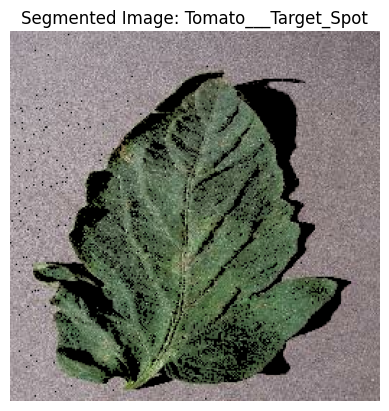

Leaf area for Tomato___Target_Spot: 57193 pixels


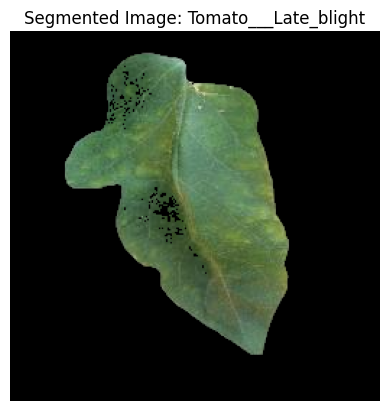

Leaf area for Tomato___Late_blight: 18874 pixels


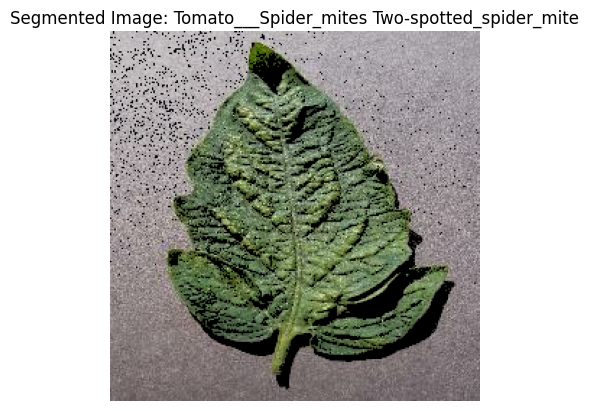

Leaf area for Tomato___Spider_mites Two-spotted_spider_mite: 58034 pixels


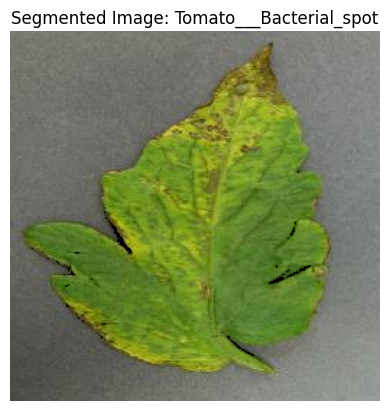

Leaf area for Tomato___Bacterial_spot: 65341 pixels


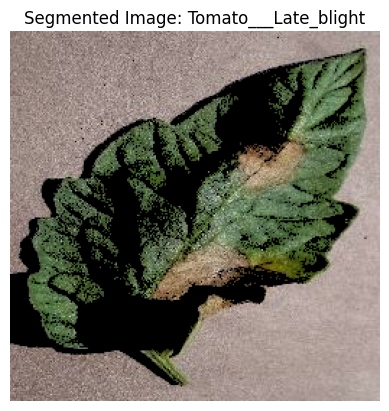

Leaf area for Tomato___Late_blight: 49699 pixels


In [44]:
import tensorflow as tf
import tensorflow_datasets as tfds
import matplotlib.pyplot as plt
import numpy as np

# Function to preprocess images
def preprocess_image(image, label):
    # Resize and normalize the image
    image = tf.image.resize(image, [256, 256])
    image = image / 255.0
    return image, label

# Function to preprocess and filter tomato images
def preprocess_and_filter(image, label):
    image, label = preprocess_image(image, label)
    label_str = info.features['label'].int2str(label.numpy())
    is_tomato = tf.strings.regex_full_match(label_str, ".*Tomato.*")
    return is_tomato, image, label_str

def apply_preprocess_and_filter(image, label):
    return tf.py_function(preprocess_and_filter, [image, label], [tf.bool, tf.float32, tf.string])

def filter_tomato(is_tomato, image, label):
    return is_tomato

def map_to_image_label(is_tomato, image, label):
    return image, label

# Define additional augmentation functions
def color_augment(image, label):
    image = tf.image.random_brightness(image, max_delta=0.1)
    image = tf.image.random_contrast(image, lower=0.9, upper=1.4)
    image = tf.image.random_saturation(image, lower=0.9, upper=1.4)
    image = tf.clip_by_value(image, 0.0, 1.0)
    return image, label

# Function to apply color-based segmentation and mask out the background
def color_based_segmentation(image, lower_bound, upper_bound):
    mask = tf.reduce_all(tf.logical_and(lower_bound <= image, image <= upper_bound), axis=-1)
    segmented_image = tf.where(mask[..., tf.newaxis], image, tf.zeros_like(image))  # Keep segmented parts, set background to black
    return segmented_image

def apply_segmentation(image, label):
    lower_bound = tf.constant([0.2, 0.2, 0.0], dtype=tf.float32)  # Looking for red, yellow, brown
    upper_bound = tf.constant([1.0, 1.0, 0.8], dtype=tf.float32)
    segmented_image = color_based_segmentation(image, lower_bound, upper_bound)
    return segmented_image, label

# Function to calculate leaf area
def calculate_leaf_area(segmented_image, label):
    # Convert the image to grayscale
    grayscale_image = tf.image.rgb_to_grayscale(segmented_image)
    # Threshold the grayscale image to create a binary mask
    binary_mask = tf.where(grayscale_image > 0, 1, 0)
    # Calculate the area as the sum of the mask values
    leaf_area = tf.reduce_sum(binary_mask)
    return leaf_area, label

# Function to display images and print leaf area
def display_images_and_area(dataset, num_examples=5, title="Image"):
    for i, (image, label) in enumerate(dataset.take(num_examples)):
        plt.imshow(image.numpy(), cmap='gray')
        plt.title(f"{title}: {label.numpy().decode('utf-8')}")
        plt.axis('off')
        plt.show()

        # Calculate and print the leaf area
        leaf_area, label = calculate_leaf_area(image, label)
        print(f"Leaf area for {label.numpy().decode('utf-8')}: {leaf_area.numpy()} pixels")

# Load the PlantVillage dataset
dataset, info = tfds.load('plant_village', with_info=True, as_supervised=True)
train_dataset = dataset['train']

# Apply preprocessing and filtering to the dataset
processed_dataset = train_dataset.map(apply_preprocess_and_filter, num_parallel_calls=tf.data.experimental.AUTOTUNE)
tomato_dataset = processed_dataset.filter(filter_tomato).map(map_to_image_label)

# Apply segmentation to the tomato dataset
segmented_tomato_dataset = tomato_dataset.map(lambda image, label: tf.py_function(apply_segmentation, [image, label], [tf.float32, tf.string]))

# Display segmented images and calculate leaf area for a subset of examples
display_images_and_area(segmented_tomato_dataset, num_examples=5, title="Segmented Image")


Number of images in the processed_dataset: 18159
Image 0 shape: (256, 256, 3), label: Tomato___Target_Spot
Image 1 shape: (256, 256, 3), label: Tomato___Late_blight
Image 2 shape: (256, 256, 3), label: Tomato___Spider_mites Two-spotted_spider_mite
Image 3 shape: (256, 256, 3), label: Tomato___Bacterial_spot
Image 4 shape: (256, 256, 3), label: Tomato___Late_blight
           LeafArea
count  18159.000000
mean   56562.014208
std     7074.091276
min     3405.000000
25%    52824.500000
50%    57071.000000
75%    61816.000000
max    65536.000000


<Figure size 1200x600 with 0 Axes>

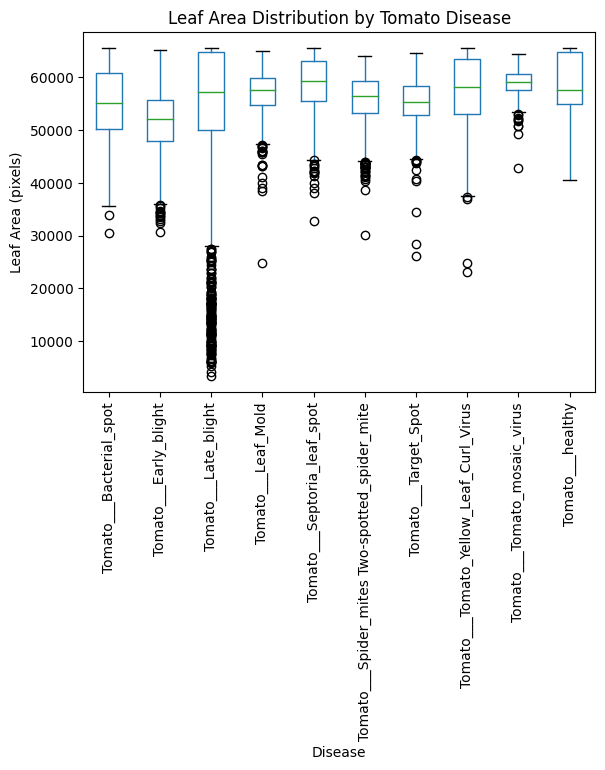

In [45]:
import tensorflow as tf
import tensorflow_datasets as tfds
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

# Function to preprocess images
def preprocess_image(image, label):
    # Resize and normalize the image
    image = tf.image.resize(image, [256, 256])
    image = image / 255.0
    return image, label

# Function to preprocess and filter tomato images
def preprocess_and_filter(image, label):
    image, label = preprocess_image(image, label)
    label_str = info.features['label'].int2str(label.numpy())
    is_tomato = tf.strings.regex_full_match(label_str, ".*Tomato.*")
    return is_tomato, image, label_str

def apply_preprocess_and_filter(image, label):
    return tf.py_function(preprocess_and_filter, [image, label], [tf.bool, tf.float32, tf.string])

def filter_tomato(is_tomato, image, label):
    return is_tomato

def map_to_image_label(is_tomato, image, label):
    return image, label

# Define additional augmentation functions
def color_augment(image, label):
    image = tf.image.random_brightness(image, max_delta=0.1)
    image = tf.image.random_contrast(image, lower=0.9, upper=1.4)
    image = tf.image.random_saturation(image, lower=0.9, upper=1.4)
    image = tf.clip_by_value(image, 0.0, 1.0)
    return image, label

# Function to apply color-based segmentation and mask out the background
def color_based_segmentation(image, lower_bound, upper_bound):
    mask = tf.reduce_all(tf.logical_and(lower_bound <= image, image <= upper_bound), axis=-1)
    segmented_image = tf.where(mask[..., tf.newaxis], image, tf.zeros_like(image))  # Keep segmented parts, set background to black
    return segmented_image

def apply_segmentation(image, label):
    lower_bound = tf.constant([0.2, 0.2, 0.0], dtype=tf.float32)  # Looking for red, yellow, brown
    upper_bound = tf.constant([1.0, 1.0, 0.8], dtype=tf.float32)
    segmented_image = color_based_segmentation(image, lower_bound, upper_bound)
    return segmented_image, label

@tf.function
def calculate_leaf_area(segmented_image):
    # Convert the image to grayscale
    grayscale_image = tf.image.rgb_to_grayscale(segmented_image)
    # Threshold the grayscale image to create a binary mask
    binary_mask = tf.where(grayscale_image > 0, 1, 0)
    # Calculate the area as the sum of the mask values
    leaf_area = tf.reduce_sum(binary_mask)
    return leaf_area

# Calculate leaf area for all images and store the results
def calculate_leaf_areas(dataset):
    results = []
    for image, label in dataset:
        leaf_area = calculate_leaf_area(image).numpy()
        label_str = label.numpy().decode('utf-8')
        results.append((label_str, leaf_area))
    return results

# Load the PlantVillage dataset
dataset, info = tfds.load('plant_village', with_info=True, as_supervised=True)
train_dataset = dataset['train']

# Apply preprocessing and filtering to the dataset
processed_dataset = train_dataset.map(apply_preprocess_and_filter, num_parallel_calls=tf.data.experimental.AUTOTUNE)
processed_dataset = processed_dataset.filter(filter_tomato).map(map_to_image_label)

# Apply segmentation to the dataset
processed_dataset = processed_dataset.map(lambda image, label: tf.py_function(apply_segmentation, [image, label], [tf.float32, tf.string]))

# Manually count the number of images in the processed_dataset
def count_images(dataset):
    count = 0
    for _ in dataset:
        count += 1
    return count

num_images = count_images(processed_dataset)
print(f"Number of images in the processed_dataset: {num_images}")

# Display image shapes and labels for a few examples
def display_image_info(dataset, num_examples=5):
    for i, (image, label) in enumerate(dataset.take(num_examples)):
        print(f"Image {i} shape: {image.shape}, label: {label.numpy().decode('utf-8')}")

# Display information for a subset of images
display_image_info(processed_dataset, num_examples=5)

# Calculate leaf areas for the entire dataset
leaf_areas = calculate_leaf_areas(processed_dataset)

# Convert results to a DataFrame for analysis
df_leaf_areas = pd.DataFrame(leaf_areas, columns=['Label', 'LeafArea'])

# Display some statistics
print(df_leaf_areas.describe())

# Plot the distribution of leaf areas for different diseases
plt.figure(figsize=(12, 6))
df_leaf_areas.boxplot(by='Label', column=['LeafArea'], grid=False)
plt.xticks(rotation=90)
plt.title('Leaf Area Distribution by Tomato Disease')
plt.suptitle('')
plt.xlabel('Disease')
plt.ylabel('Leaf Area (pixels)')
plt.show()


Analysis of the Plot

Overall Trends:

Most diseases have a fairly wide range of leaf areas, indicating variability in leaf size affected by different diseases.

Specific Diseases:

Tomato___Bacterial_spot: This disease shows a wide range of leaf areas, with many outliers below the lower whisker.

Tomato___Early_blight: This disease shows a smaller median leaf area and a significant number of outliers, suggesting that affected leaves are generally smaller.

Tomato___Late_blight: Has a wide range of leaf areas, with a significant number of outliers on the lower end.

Tomato___Leaf_Mold: Shows a large number of leaves with smaller areas.

Tomato___Septoria_leaf_spot: Also shows a wide range of leaf areas, with many smaller outliers.

Tomato___Spider_mites Two-spotted_spider_mite: Shows a wide distribution of leaf areas.

Tomato___Target_Spot: Has a wide range of leaf areas with fewer extreme outliers.

Tomato___Tomato_Yellow_Leaf_Curl_Virus: Shows a wide range of leaf areas.

Tomato___Tomato_mosaic_virus: Shows a wide range of leaf areas.

Tomato___healthy: Healthy leaves generally have larger areas and fewer outliers, indicating more consistency in size.

Insights

Disease Impact on Leaf Size:

Certain diseases like Tomato___Early_blight and Tomato___Leaf_Mold seem to significantly reduce leaf size, as indicated by the lower median and a large number of smaller leaf areas.
Other diseases like Tomato___Bacterial_spot and Tomato___Late_blight show a broader distribution of leaf sizes, suggesting varying impacts on leaf area.
Variability:

The variability in leaf size within the same disease indicates that the impact of the disease on leaf size can be influenced by other factors such as the stage of infection, environmental conditions, and plant health.
Healthy Leaves:

Healthy leaves (Tomato___healthy) tend to have larger and more consistent areas, which serves as a good baseline for comparison with diseased leaves.

In [46]:
# Verify the new dataset
# Print the first few elements to verify the new structure
for processed_image, label in processed_dataset.take(10):
    print("Processed image shape:", processed_image.shape)
    print("Label:", label.numpy().decode('utf-8'))


Processed image shape: (256, 256, 3)
Label: Tomato___Target_Spot
Processed image shape: (256, 256, 3)
Label: Tomato___Late_blight
Processed image shape: (256, 256, 3)
Label: Tomato___Spider_mites Two-spotted_spider_mite
Processed image shape: (256, 256, 3)
Label: Tomato___Bacterial_spot
Processed image shape: (256, 256, 3)
Label: Tomato___Late_blight
Processed image shape: (256, 256, 3)
Label: Tomato___healthy
Processed image shape: (256, 256, 3)
Label: Tomato___Spider_mites Two-spotted_spider_mite
Processed image shape: (256, 256, 3)
Label: Tomato___Tomato_mosaic_virus
Processed image shape: (256, 256, 3)
Label: Tomato___Tomato_Yellow_Leaf_Curl_Virus
Processed image shape: (256, 256, 3)
Label: Tomato___Tomato_Yellow_Leaf_Curl_Virus


### Complex Features Extraction




##### Haralick Texture

Haralick features are statistical measures of texture that describe the arrangement and properties of pixels in an image, particularly useful for capturing patterns that might be indicative of disease. These features can be computed from the grayscale image, but we compute them separately for each color channel and combine the results to retain more color information.

The output is a vector—a vector of length 15—represents the computed Haralick texture features and not the RGB image data. The Haralick features computed are derived from each color channel (RGB), but they are represented as a single-dimensional array of statistical values that describe the texture in the image, rather than the image data itself.

This is a breakdown of what happens with Hatalick:

**1. Image Conversion to Features:** Each RGB channel of the image is processed separately to generate Haralick features. These features capture texture information such as contrast, homogeneity, energy, etc., which are useful for tasks like image classification, especially in your case of identifying plant diseases.

**2. Combining Features:** Features from each channel are concatenated into a single feature vector. So if you compute 5 features (contrast, dissimilarity, homogeneity, energy, correlation) from each of the 3 channels (RGB), you end up with a 15-element vector for each image.

**3. Feature Vector:** The resulting 15-element vector per image no longer retains the spatial or color information like the original RGB images. Instead, it provides a summary of the textural characteristics of the image across the three channels.

Vector is typical in many machine learning workflows where raw data is converted into a more descriptive, often more compact form that ideally captures the essence of the data in relation to the task (e.g., classifying types of plant diseases).

In [47]:
# Define function to inspect image shape
def ensure_image_shape(image):
    # Check if image is less than 3D and adjust accordingly
    if tf.rank(image) == 2:
        image = tf.expand_dims(image, axis=-1)  # Assume missing channel dimension
    if tf.shape(image)[-1] == 1:
        image = tf.image.grayscale_to_rgb(image)  # Convert grayscale to RGB
    # Ensure the image has the minimum dimensions 3D for RGB images
    image = tf.ensure_shape(image, [None, None, 3])
    return image

# Define Haralick function
def haralick_features_per_channel(image):
    # image is already a NumPy array when this function is called by tf.py_function
    image = np.array(image * 255, dtype=np.uint8)  # Scale and convert to uint8

    features = []
    # Calculate Haralick features for each RGB channel
    for channel in range(3):
        glcm = graycomatrix(image[:, :, channel], distances=[1], angles=[0, np.pi/4, np.pi/2, 3*np.pi/4], levels=256, symmetric=True, normed=True)
        features.extend([graycoprops(glcm, prop).mean() for prop in ['contrast', 'dissimilarity', 'homogeneity', 'energy', 'correlation']])
    return np.array(features, dtype=np.float32)

# Extract Haralick featires
def extract_haralick_features(image, label):
    # Normalize and ensure proper shape
    image = tf.image.convert_image_dtype(image, tf.float32)  # Normalize to [0, 1]
    image = ensure_image_shape(image)

    # Resize the image
    image = tf.image.resize(image, [256, 256])

    # Use tf.py_function to apply the Haralick features extraction
    features = tf.py_function(haralick_features_per_channel, [image], tf.float32)
    features.set_shape([15])  # Set a known shape for the features if known
    return features, label

# Example usage within a dataset pipeline
haralick_dataset = processed_dataset.map(extract_haralick_features)

# Inspect output
try:
    for features, label in haralick_dataset.take(3):
        print("Features shape:", features.shape)
        print("Label:", label.numpy().decode('utf-8'))
except Exception as e:
    print("Error during processing:", e)

Features shape: (15,)
Label: Tomato___Target_Spot
Features shape: (15,)
Label: Tomato___Late_blight
Features shape: (15,)
Label: Tomato___Spider_mites Two-spotted_spider_mite


#### ResNet50

Extracting features using a pre-trained model like ResNet can capture high-level patterns in the data that are beneficial for complex image classification tasks.

In [48]:
# Load ResNet50 without the top layer to use as a feature extractor
resnet_model = ResNet50(include_top=False, weights='imagenet', pooling='avg')

# Define the Feature Extraction Function
def extract_resnet_features(image, label):
    # Expand dimensions to match the expected input of ResNet
    image = tf.expand_dims(image, axis=0)
    # Preprocess the image for ResNet50
    image = preprocess_input(image)
    # Extract features
    features = resnet_model(image, training = False)
    # Remove the batch dimension
    features = tf.reshape(features, [-1])
    return features, label

# Apply the Function Over the Dataset
# Map the feature extraction over your dataset
resnet_features_dataset = processed_dataset.map(extract_resnet_features)


94765736/94765736 [==============================] - 5s 0us/step


In [49]:
# Verify features extraction
# Print first 10 features to inspect values
for features, label in resnet_features_dataset.take(5):
    print("Features shape:", features.shape)
    print("Label:", label.numpy().decode('utf-8'))


Features shape: (2048,)
Label: Tomato___Target_Spot
Features shape: (2048,)
Label: Tomato___Late_blight
Features shape: (2048,)
Label: Tomato___Spider_mites Two-spotted_spider_mite
Features shape: (2048,)
Label: Tomato___Bacterial_spot
Features shape: (2048,)
Label: Tomato___Late_blight


Normalize features to avoid predominance before set up classifiers. It can help to avoid issues where certain features might dominate the learning process due to their larger scale compared to other features. This can improve the convergence speed of the training algorithm and often leads to better performance.

In [50]:
# Assuming resnet_features_dataset contains the feature vectors
def min_max_scaling(features, label):
    # Min-Max scaling to range [0, 1]
    min_val = tf.reduce_min(features)
    max_val = tf.reduce_max(features)
    scaled_features = (features - min_val) / (max_val - min_val)
    return scaled_features, label

# Apply min-max scaling to the dataset
normalized_features_dataset = resnet_features_dataset.map(min_max_scaling)

# Example to iterate and print normalized features and labels
for features, label in normalized_features_dataset.take(3):
    print("Normalized features shape:", features.shape)
    print("Label:", label.numpy().decode('utf-8'))
    print("Sample features:", features.numpy()[:10])  # Print first 10 features to check


Normalized features shape: (2048,)
Label: Tomato___Target_Spot
Sample features: [0.         0.         0.         0.         0.00043501 0.
 0.         0.00034927 0.00353297 0.        ]
Normalized features shape: (2048,)
Label: Tomato___Late_blight
Sample features: [0.         0.         0.         0.         0.00102632 0.
 0.         0.00145886 0.00181864 0.        ]
Normalized features shape: (2048,)
Label: Tomato___Spider_mites Two-spotted_spider_mite
Sample features: [0.0000000e+00 0.0000000e+00 0.0000000e+00 1.4362458e-05 0.0000000e+00
 0.0000000e+00 0.0000000e+00 0.0000000e+00 3.2907403e-03 0.0000000e+00]


To visualize normalized features (2048,), we used PCA to project the features into two dimensions. This can provide a visual way to see the clustering and separation of the feature vectors. Below, we first visualized the first 100 features, and after 1000 features.

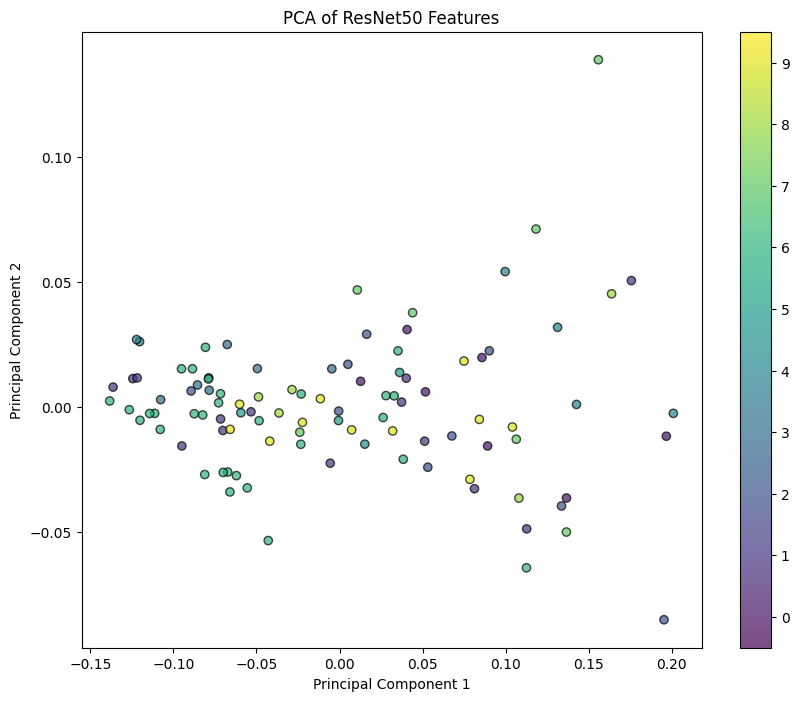

In [51]:
# Collect features and labels
features_list = []
labels_list = []
for features, label in normalized_features_dataset.take(100):  # Take 100 samples for visualization
    features_list.append(features.numpy())
    labels_list.append(label.numpy().decode('utf-8'))

# Convert to numpy arrays for PCA
features_array = np.array(features_list)
labels_array = np.array(labels_list)

# PCA to reduce dimensions to 2
pca = PCA(n_components=2)
reduced_features = pca.fit_transform(features_array)

# Plotting the results
plt.figure(figsize=(10, 8))
scatter = plt.scatter(reduced_features[:, 0], reduced_features[:, 1], c=pd.factorize(labels_array)[0], cmap='viridis', edgecolor='k', alpha=0.7)
plt.title('PCA of ResNet50 Features')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.colorbar(scatter, ticks=range(len(np.unique(labels_array))))
plt.clim(-0.5, len(np.unique(labels_array))-0.5)
plt.show()


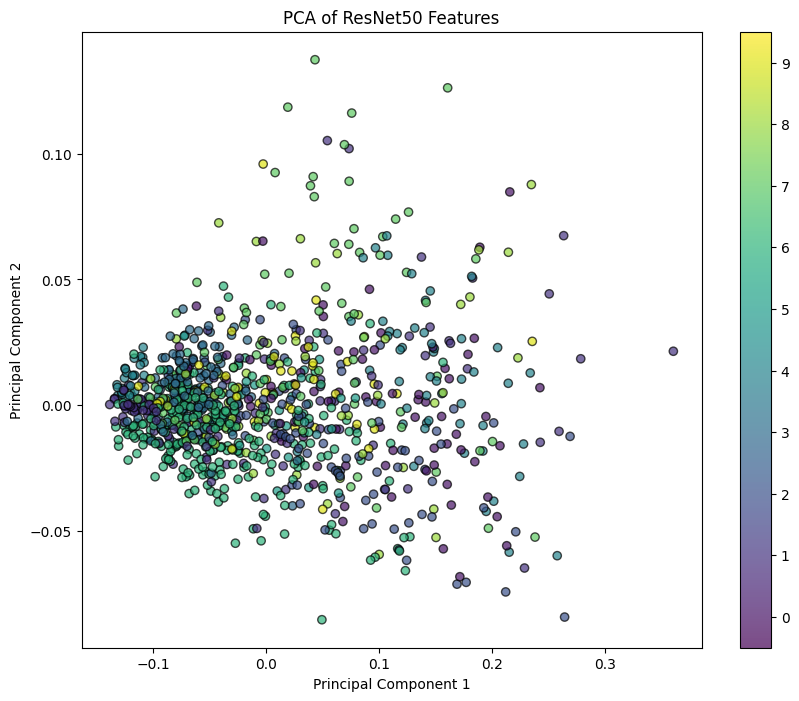

In [52]:
# Collect features and labels
features_list = []
labels_list = []
for features, label in normalized_features_dataset.take(1000):  # Take 1000 samples for visualization
    features_list.append(features.numpy())
    labels_list.append(label.numpy().decode('utf-8'))

# Convert to numpy arrays for PCA
features_array = np.array(features_list)
labels_array = np.array(labels_list)

# PCA to reduce dimensions to 2
pca = PCA(n_components=2)
reduced_features = pca.fit_transform(features_array)

# Plotting the results
plt.figure(figsize=(10, 8))
scatter = plt.scatter(reduced_features[:, 0], reduced_features[:, 1], c=pd.factorize(labels_array)[0], cmap='viridis', edgecolor='k', alpha=0.7)
plt.title('PCA of ResNet50 Features')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.colorbar(scatter, ticks=range(len(np.unique(labels_array))))
plt.clim(-0.5, len(np.unique(labels_array))-0.5)
plt.show()


## Model

Combine resnet features with the haralick features. haralick_dataset and resnet_dataset are not in the same order right now (so we can not simply zip and concat), so we must create a new function.

In [53]:
def extract_all_features(image, label):
    # Get Haralick features; same steps as extract_haralick_features function
    image = tf.image.convert_image_dtype(image, tf.float32)  # Normalize to [0, 1]
    image = ensure_image_shape(image)
    image = tf.image.resize(image, [256, 256])
    haralick_features = tf.py_function(haralick_features_per_channel, [image], tf.float32)
    haralick_features.set_shape([15])  # Set a known shape for the features if known

    # Get resnet features; same steps as extract_resnet_features function
    image = tf.expand_dims(image, axis=0)
    image = preprocess_input(image)
    resnet_features = resnet_model(image, training = False)
    resnet_features = tf.reshape(resnet_features, [-1])

    # combine features
    combined_features = tf.concat([resnet_features, haralick_features], axis=-1)  # Concatenate along the last axis

    return combined_features, label

combined_dataset = processed_dataset.map(extract_all_features)

# Apply min-max scaling to the dataset
normalized_combined_dataset = combined_dataset.map(min_max_scaling)


Check that the shape of features is as we expect

In [54]:
# Inspect dataset
# Create inspecting function
def inspect_dataset(dataset):
    for features, label in dataset.take(3):  # Taking one sample to inspect
        print("Features shape:", features.shape)
        print("Features dtype:", features.dtype)
        print("Label:", label.numpy().decode('utf-8'))
        print("Label dtype:", label.dtype)

# Applying the inspection function; there should be 2063 features, 2048 (from resnet) + 15 (from haralick)
inspect_dataset(normalized_combined_dataset)


Features shape: (2063,)
Features dtype: <dtype: 'float32'>
Label: Tomato___Target_Spot
Label dtype: <dtype: 'string'>
Features shape: (2063,)
Features dtype: <dtype: 'float32'>
Label: Tomato___Late_blight
Label dtype: <dtype: 'string'>
Features shape: (2063,)
Features dtype: <dtype: 'float32'>
Label: Tomato___Spider_mites Two-spotted_spider_mite
Label dtype: <dtype: 'string'>


Due to the high number of features, we can implement several machine learning models, like Supported Vector Machine (SVM), Random Forest, or Neural Networks.

### Dataset Splitting

1. Collect the Data: We need to iterate over the dataset to collect the feature vectors and labels into lists.

2. Shuffle the Data: It's crucial to shuffle the data to ensure that the training, validation, and test sets are representative of the overall distribution.

3. Split the Data: Allocate 70% of the data to training, 15% to validation, and 15% to testing.

First, lets encode the output label into integers

In [55]:
import tensorflow as tf

# Get unique labels from your dataset
unique_labels = set()

# looping through normalized_combined_dataset takes significantly longer so we loop through tomato_dataset since they have the same labels anyways
for _, label in tomato_dataset:
    unique_labels.add(label.numpy().decode('utf-8'))

# Create a StringLookup layer
label_encoder = tf.keras.layers.StringLookup(vocabulary=list(unique_labels))

# Function to encode labels
def encode_labels(features, label):
    encoded_label = label_encoder(label)
    return features, encoded_label

# Apply label encoding to the dataset
encoded_dataset = normalized_combined_dataset.map(encode_labels)

# Verify the encoded labels
for features, label in encoded_dataset.take(5):
    print("Features shape:", features.shape)
    print("Features dtype:", features.dtype)
    print("Label:", label.numpy())
    print("Label dtype:", label.dtype)

Features shape: (2063,)
Features dtype: <dtype: 'float32'>
Label: 7
Label dtype: <dtype: 'int64'>
Features shape: (2063,)
Features dtype: <dtype: 'float32'>
Label: 10
Label dtype: <dtype: 'int64'>
Features shape: (2063,)
Features dtype: <dtype: 'float32'>
Label: 6
Label dtype: <dtype: 'int64'>
Features shape: (2063,)
Features dtype: <dtype: 'float32'>
Label: 5
Label dtype: <dtype: 'int64'>
Features shape: (2063,)
Features dtype: <dtype: 'float32'>
Label: 10
Label dtype: <dtype: 'int64'>


To get rid of the 0:[UNK] label, which is something that Keras does to automatically allocate unknown label, we changed the code, as all labels are allocated correctly.
We then adjust the 'StringLookup' layer to exclude it.

In [56]:
# To get rid of the 0[UNK] label, which is something that Keras does to automatically allocate unknown label, we changed the code:
# Adjust the StringLookup Layer:
# Collect unique labels from the dataset
unique_labels = set()
for _, label in tomato_dataset:
    unique_labels.add(label.numpy().decode('utf-8'))

# Create a StringLookup layer without the [UNK] token
label_encoder = tf.keras.layers.StringLookup(vocabulary=list(unique_labels), num_oov_indices=0)

# Function to encode labels
def encode_labels(features, label):
    # Ensure the label is a scalar string tensor
    label = tf.reshape(label, [])
    encoded_label = label_encoder(label)
    return features, encoded_label

# Apply label encoding to the dataset
encoded_dataset = normalized_combined_dataset.map(encode_labels)

# Verify the encoded labels
for features, label in encoded_dataset.take(5):
    print("Features shape:", features.shape)
    print("Features dtype:", features.dtype)
    print("Label:", label.numpy())
    print("Label dtype:", label.dtype)

# Get the label mapping
mapping = label_encoder.get_vocabulary()

# Print the mapping
print("Mapping:")
for idx, item in enumerate(mapping):
    print(f"{idx}: {item}")


Features shape: (2063,)
Features dtype: <dtype: 'float32'>
Label: 6
Label dtype: <dtype: 'int64'>
Features shape: (2063,)
Features dtype: <dtype: 'float32'>
Label: 9
Label dtype: <dtype: 'int64'>
Features shape: (2063,)
Features dtype: <dtype: 'float32'>
Label: 5
Label dtype: <dtype: 'int64'>
Features shape: (2063,)
Features dtype: <dtype: 'float32'>
Label: 4
Label dtype: <dtype: 'int64'>
Features shape: (2063,)
Features dtype: <dtype: 'float32'>
Label: 9
Label dtype: <dtype: 'int64'>
Mapping:
0: Tomato___healthy
1: Tomato___Tomato_mosaic_virus
2: Tomato___Septoria_leaf_spot
3: Tomato___Early_blight
4: Tomato___Bacterial_spot
5: Tomato___Spider_mites Two-spotted_spider_mite
6: Tomato___Target_Spot
7: Tomato___Tomato_Yellow_Leaf_Curl_Virus
8: Tomato___Leaf_Mold
9: Tomato___Late_blight


In [57]:
import numpy as np

# Convert the list of labels to a NumPy array
mapping_array = np.array(mapping)  # Convert the list of labels to a NumPy array

# Save the array to an .npy file
np.save("/content/drive/MyDrive/Colab Notebooks/w281_Final Project/Final/class_mapping.npy", mapping_array)


In [58]:
# Calculate the total number of samples in the dataset (it takes apprx. 40 minutes)
total_samples = 0
for _ in encoded_dataset:
    total_samples += 1

print("Total samples:", total_samples)

Total samples: 18159


Next, shuffle the dataset and split it into train/val/test sets.

In [59]:
# get total number of tomato samples
total_samples = len(list(tomato_dataset))

# define proportions
proportions = {
    'train': 0.7,
    'valid': 0.15,
    'test': 0.15
}
print(total_samples)

18159


In [60]:
# set seed and shuffle
tf.random.set_seed(42)
encoded_dataset = encoded_dataset.shuffle(buffer_size=1024)

# compute number of samples in each split
train_size = int(proportions['train'] * total_samples)
valid_size = int(proportions['valid'] * total_samples)
test_size = total_samples - train_size - valid_size

# create splits
train_set = encoded_dataset.take(train_size)
valid_set = encoded_dataset.skip(train_size).take(valid_size)
test_set = encoded_dataset.skip(train_size + valid_size)

Check that the sizes of the splits are as we expect

In [62]:
# takes so long... because extracting the resnet features is computed at runtime (it takes 98 minutes)
train_count = len(list(train_set))
valid_count = len(list(valid_set))
test_count = len(list(test_set))

# print("Train set size:", train_count)
# print("Validation set size:", valid_count)
# print("Test set size:", test_count)

Train set size: 12711
Validation set size: 2723
Test set size: 2725


In [63]:
print("Train set size:", train_count)
print("Validation set size:", valid_count)
print("Test set size:", test_count)

Train set size: 12711
Validation set size: 2723
Test set size: 2725


### Define X (features) and y (labels) for each split

In [ ]:
# save train data in numpy array (it takes 28 minutes)
train_list = list(train_set.as_numpy_iterator())
X_train = [item[0] for item in train_list]
y_train = [item[1] for item in train_list]
np.save("/content/drive/MyDrive/Colab Notebooks/w281_Final Project/X_train.npy", np.array(X_train))
np.save("/content/drive/MyDrive/Colab Notebooks/w281_Final Project/y_train.npy", np.array(y_train))

In [ ]:
# Convert lists to NumPy arrays
X_train_array = np.array(X_train)
y_train_array = np.array(y_train)

# Now, you can check the shapes of these arrays
print("X_train shape:", X_train_array.shape)
print("y_train shape:", y_train_array.shape)

In [ ]:
# save validation data in numpy array (it takes 33 minutes)
valid_list = list(valid_set.as_numpy_iterator())
X_valid = [item[0] for item in valid_list]
y_valid = [item[1] for item in valid_list]
np.save("/content/drive/MyDrive/Colab Notebooks/w281_Final Project/X_valid.npy", np.array(X_valid))
np.save("/content/drive/MyDrive/Colab Notebooks/w281_Final Project/y_valid.npy", np.array(y_valid))


In [ ]:
# Convert lists to NumPy arrays
X_val_array = np.array(X_valid)
y_val_array = np.array(y_valid)

# Check shapes of the NumPy arrays
print("X_valid shape:", X_val_array.shape)
print("y_valid shape:", y_val_array.shape)

In [ ]:
# save test data in numpy arrays (it takes 37 minutes)
test_list = list(test_set.as_numpy_iterator())
X_test = [item[0] for item in test_list]
y_test = [item[1] for item in test_list]
np.save("/content/drive/MyDrive/Colab Notebooks/w281_Final Project/X_test.npy", np.array(X_test))
np.save("/content/drive/MyDrive/Colab Notebooks/w281_Final Project/y_test.npy", np.array(y_test))

In [ ]:
# Convert lists to NumPy arrays
X_test_array = np.array(X_test)
y_test_array = np.array(y_test)

# check shapes of the numpy arrays
print("y_test shape:", X_test_array.shape)
print("y_test shape:", y_test_array.shape)

#### Classifier Training and Evaluation


See Modeling_Agnese.ipynb